<a href="https://colab.research.google.com/github/skc46/Microstructure_recognition/blob/master/final_project_group_L.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [24]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.image import imread
from numpy import asarray, save
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import random
import visualkeras


In [ ]:
pip install visualkeras

     |████████████████████████████████| 798kB 7.9MB/s 


In [25]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).
/gdrive


https://drive.google.com/drive/folders/1xFGEqBKgJLVXi-vnrHybhyDeskgEJrUg?usp=sharing

In [26]:
cd ./MyDrive/machine_learning/project_images/


/gdrive/MyDrive/machine_learning/project_images


### Data augmentation steps

You can skip these steps, if you don't want to do data augmentation.

In [ ]:
# auto-augmentation
gen = ImageDataGenerator(rotation_range=20, shear_range=0.1, zoom_range=0.20, channel_shift_range=10, horizontal_flip=True)

In [ ]:
single_x = []

IMG_SIZE = 299  # iamge size we want

def create_training_data():
        path = os.path.join(DATADIR, 'Single-Phase')
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path,img), cv2.IMREAD_COLOR)
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            single_x.append(new_array)
            
create_training_data()  

In [ ]:
x = np.array(single_x)

In [ ]:
mkdir Augmented_single

In [ ]:
i = 0
for batch in gen.flow(x, batch_size=400, save_to_dir='Augmented_single', save_prefix='aug', save_format='jpg'):
  i +=1
  if i >5:
    break

### Create training dataset

In [ ]:
DATADIR = "./Train"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

training_data = []

IMG_SIZE = 299  # image size we want

def create_training_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img))
            #im = cv2.imread(os.path.join(path,img), cv2.IMREAD_COLOR) # for BGR representation and also cv2.IMREAD_GRAYSCALE for grayscale  
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)   # if using BGR and Grayscale comment this
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            training_data.append([new_array, class_num])
            
create_training_data()            


In [ ]:
# data shuffling
import random

random.shuffle(training_data)

### Creating feature matrix and label for training data

In [ ]:
photos = []
labels = []

for features, label in training_data:
    photos.append(features)
    labels.append(label)
    
X_train= np.array(photos).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3   
y_train = np.array(labels) 

In [27]:
print(X_train.shape, y_train.shape)

(1107, 299, 299, 3) (1107,)


#### If you other ways of creating image array is desired, you can use this cell.Otherwise skip it.

In [ ]:
# other ways of creating image arrays
DATADIR = "./Train"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

training_data = []

def create_training_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            #img_array = imread(os.path.join(path,img))
            photo = load_img(os.path.join(path,img), target_size=(256,256,3))
            photo= img_to_array(photo)
            training_data.append([photo, class_num])
            
create_training_data()   

### Creating Test data

In [ ]:
DATADIR = "./Test"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

test_data = []


def create_test_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img))
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            test_data.append([new_array, class_num])
            
create_test_data()  

random.shuffle(test_data)


In [ ]:
# other ways of creating image arrays
DATADIR = "./Test"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

test_data = []

def create_test_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            #img_array = imread(os.path.join(path,img))
            photo = load_img(os.path.join(path,img), target_size=(256,256,3))
            photo= img_to_array(photo)
            test_data.append([photo, class_num])
            
create_test_data()   

In [ ]:
# Creating feature matrix and labels
feature_test = []
labels_test = []


for features, label in test_data:
    feature_test.append(features)
    labels_test.append(label)
    
X_test= np.array(feature_test).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3 
y_test = np.array(labels_test)

In [ ]:
X_test.shape

(176, 299, 299, 3)

### Visualizing a few images

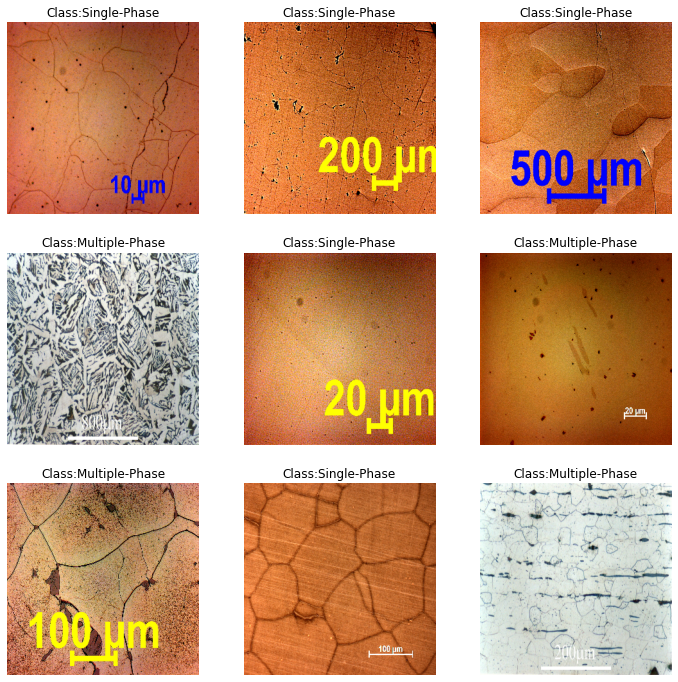

In [ ]:
# let's visualized test images
plt.figure(figsize=(12,12))
index=0
for img,lbl in zip(X_train[:9,],y_train[:9,]):
    index +=1
    plt.subplot(3,3,index)
    plt.imshow(img)
    plt.title("Class:{}".format(CATEGORIES[lbl]))
    plt.axis("off")
plt.show()

In [ ]:
# scaling the train and test data pixel values
X_train_scaled = X_train/ 255.

X_test_scaled = X_test/ 255.

In [ ]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)

    except RuntimeError as e:
        print(e)

In [28]:
import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, GlobalAveragePooling2D, GlobalAvgPool2D
from tensorflow.keras.optimizers import Adam,Adamax
from sklearn.model_selection import GridSearchCV


### Hyperparameter Tuning

##### Optimizer selection

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model_optimizer(optimizer):
    model = Sequential([
        Conv2D(16, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(128, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(32, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer=optimizer, metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_optimizer = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model_optimizer)    

# parameter selection
param_distribs = {
    'optimizer':['sgd', 'adagrad', 'rmsprop', 'adam', 'nadam', 'adamax', 'adadelta']
    }

optimizer_search_cv = GridSearchCV(keras_classi_optimizer, param_distribs, cv=3)    

grid_result = optimizer_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))


12/12 [==============================] - 1s 33ms/step - loss: 0.4467 - accuracy: 0.7995
Best: 0.908762 using {'optimizer': 'adamax'}
0.812105 (0.118217) with: {'optimizer': 'sgd'}
0.899729 (0.010140) with: {'optimizer': 'adagrad'}
0.815718 (0.070356) with: {'optimizer': 'rmsprop'}
0.803975 (0.065279) with: {'optimizer': 'adam'}
0.621500 (0.205681) with: {'optimizer': 'nadam'}
0.908762 (0.006388) with: {'optimizer': 'adamax'}
0.791328 (0.011498) with: {'optimizer': 'adadelta'}


### Finding the best Activation Function

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model(activation='relu'):
    model = Sequential([
        Conv2D(16, 5, activation=activation, padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation=activation, padding='same'),
        BatchNormalization(),
        Conv2D(64, 3, activation=activation, padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(128, 3, activation=activation, padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation=activation, padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(128, activation=activation),
        BatchNormalization(),
        Dropout(0.3),
        Dense(32, activation=activation),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer='adamax', metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_activation = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model)    

# parameter selection
param_distribs = {
    'activation':['softsign', 'relu', 'tanh', 'sigmoid', 'hard_sigmoid', 'linear','elu']
    }

activation_search_cv = GridSearchCV(keras_classi_activation, param_distribs, cv=3)    

grid_result = activation_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))


12/12 [==============================] - 1s 39ms/step - loss: 0.2445 - accuracy: 0.8889
Best: 0.888889 using {'activation': 'relu'}
0.857272 (0.006388) with: {'activation': 'softsign'}
0.888889 (0.024340) with: {'activation': 'relu'}
0.872629 (0.020280) with: {'activation': 'tanh'}
0.856369 (0.007978) with: {'activation': 'sigmoid'}
0.863595 (0.010915) with: {'activation': 'hard_sigmoid'}
0.797651 (0.038728) with: {'activation': 'linear'}
0.878049 (0.017282) with: {'activation': 'elu'}


### Finding number of neurons in the Dense layers and the no. of filters

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model(filters, neurons):
    model = Sequential([
        Conv2D(filters, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D((filters*2), 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D((filters*4), 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D((filters*8), 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D((filters*8), 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(neurons, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(neurons/4, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer='adamax', metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_neurons_filters = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model)    

# parameter selection
param_distribs = {
    'filters':[8, 16, 32,64],
    'neurons':[64,128,256,512,1024]
    }

neurons_search_cv = GridSearchCV(keras_classi_neurons_filters, param_distribs, cv=3)    

grid_result = neurons_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))

12/12 [==============================] - 2s 115ms/step - loss: 0.2335 - accuracy: 0.9160
Best: 0.916893 using {'filters': 32, 'neurons': 1024}
0.897922 (0.014053) with: {'filters': 8, 'neurons': 64}
0.897922 (0.018819) with: {'filters': 8, 'neurons': 128}
0.914182 (0.009212) with: {'filters': 8, 'neurons': 256}
0.884372 (0.041119) with: {'filters': 8, 'neurons': 512}
0.868112 (0.039355) with: {'filters': 8, 'neurons': 1024}
0.906052 (0.016900) with: {'filters': 16, 'neurons': 64}
0.871725 (0.016900) with: {'filters': 16, 'neurons': 128}
0.906052 (0.020078) with: {'filters': 16, 'neurons': 256}
0.905149 (0.000000) with: {'filters': 16, 'neurons': 512}
0.898826 (0.015698) with: {'filters': 16, 'neurons': 1024}
0.878049 (0.044088) with: {'filters': 32, 'neurons': 64}
0.890696 (0.011355) with: {'filters': 32, 'neurons': 128}
0.900632 (0.013520) with: {'filters': 32, 'neurons': 256}
0.881662 (0.043153) with: {'filters': 32, 'neurons': 512}
0.916893 (0.017885) with: {'filters': 32, 'neurons'

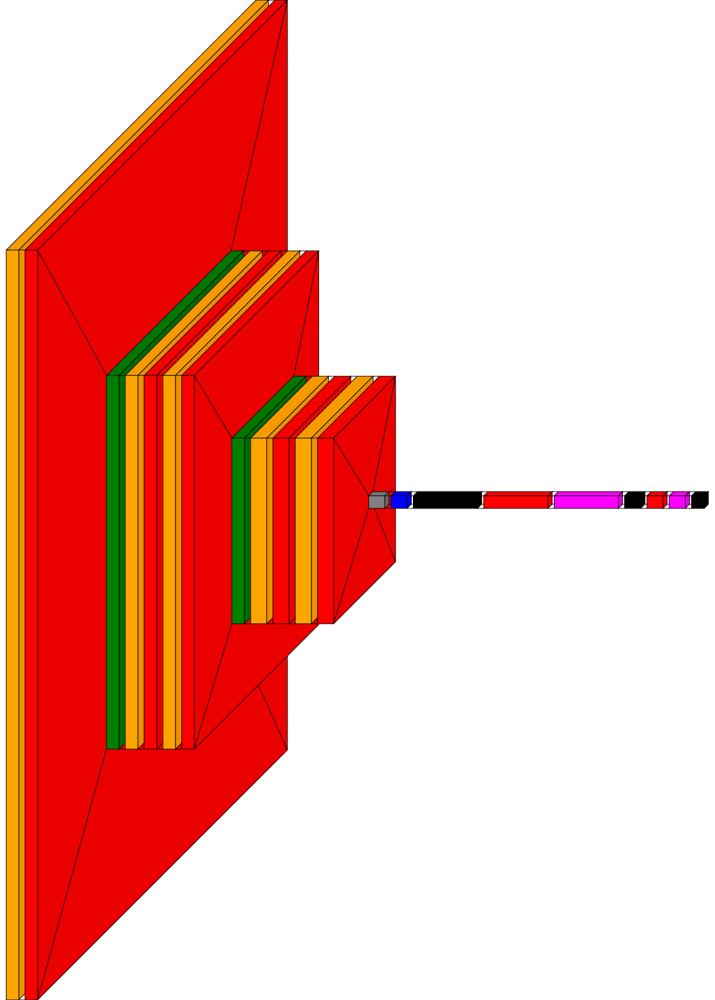

In [33]:
tensorflow.keras.backend.clear_session()
from collections import defaultdict
model = Sequential([
        Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
        
batch_size=16
s = 30*len(X_train_scaled)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])
#model.summary()
color_map = defaultdict(dict)
color_map[Conv2D]['fill'] = 'orange'
color_map[MaxPooling2D]['fill'] = 'green'
color_map[BatchNormalization]['fill'] = 'red'
color_map[GlobalAveragePooling2D]['fill'] = 'gray'
color_map[Flatten]['fill'] = 'blue'
color_map[Dense]['fill']='black'
color_map[Dropout]['fill']='magenta'
visualkeras.layered_view(model, color_map = color_map).show()
visualkeras.layered_view(model, color_map = color_map, to_file='cnn.png')


In [ ]:
# train the model
history = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15)

Epoch 1/50
59/59 [==============================] - 9s 125ms/step - loss: 0.6912 - accuracy: 0.7073 - val_loss: 0.6890 - val_accuracy: 0.4970
Epoch 2/50
59/59 [==============================] - 5s 89ms/step - loss: 0.4658 - accuracy: 0.8145 - val_loss: 0.6741 - val_accuracy: 0.5629
Epoch 3/50
59/59 [==============================] - 5s 89ms/step - loss: 0.4734 - accuracy: 0.7995 - val_loss: 0.7633 - val_accuracy: 0.5808
Epoch 4/50
59/59 [==============================] - 5s 89ms/step - loss: 0.3853 - accuracy: 0.8340 - val_loss: 0.7181 - val_accuracy: 0.6048
Epoch 5/50
59/59 [==============================] - 5s 89ms/step - loss: 0.3755 - accuracy: 0.8601 - val_loss: 1.3039 - val_accuracy: 0.6048
Epoch 6/50
59/59 [==============================] - 5s 89ms/step - loss: 0.2821 - accuracy: 0.8860 - val_loss: 0.5940 - val_accuracy: 0.7066
Epoch 7/50
59/59 [==============================] - 5s 89ms/step - loss: 0.3972 - accuracy: 0.8315 - val_loss: 0.5919 - val_accuracy: 0.7126
Epoch 8/50
5

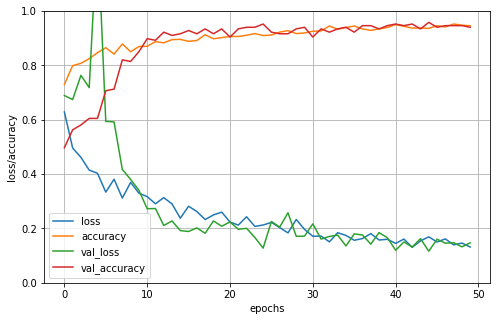

In [ ]:
# visualizing the loss and accuracy
import pandas as pd
import matplotlib.pyplot as plt

pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

In [ ]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 0s 47ms/step - loss: 0.2583 - accuracy: 0.9545

Test loss / accuracy: 0.2583 / 0.9545
Test ROC AUC: 0.9605688429217839


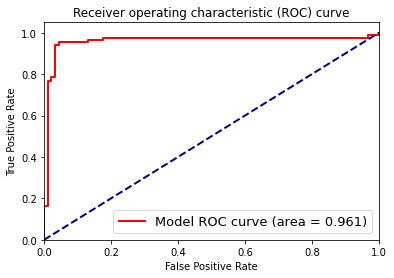

In [ ]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score
import itertools
y_pred_class = model.predict_classes(X_test_scaled) # converting probability predictions into class labels

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)

print('Precision', precision_score(y_pred_class, y_test))
print('Recall', recall_score(y_test,y_pred_class))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


Precision 0.9411764705882353
Recall 0.9411764705882353


In [ ]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
cm_plot_labels = ['Multi-phase', 'Single-phase']    

Confusion matrix, without normalization
[[88  3]
 [ 5 80]]


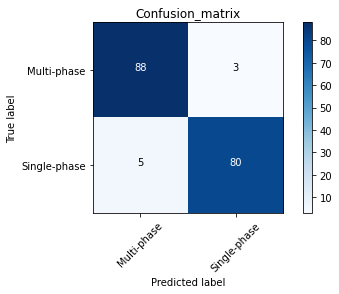

In [ ]:
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

In [ ]:
# let's visualized test images
plt.figure(figsize=(12,12))
index=0
for img in X_test:
    #plt.subplot((len(X_test)/3),3,index+1)
    plt.imshow(img)
    plt.title("actual class {} \t predicted class {}".format(y_test[index], y_pred_class[index]))
    index +=1
    plt.axis("off")
    plt.show()


In [ ]:
for i in range(29):
    print("actual class {} \t predicted class {}".format(y_test[i], y_pred_class[i]))

In [ ]:
print("actual class {} \t predicted class {}".format(y_test[0], y_pred_class[0]))

actual class 0 	 predicted class [1]


In [ ]:
import tensorflow 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, GlobalAvgPool2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import models, losses, Model, layers


### Alex Net

In [ ]:

tensorflow.keras.backend.clear_session()

model_alex = Sequential([
    Conv2D(96, 11, activation='relu', padding='valid', strides = 4, input_shape=X_train_scaled.shape[1:]),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Conv2D(256, 5, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Conv2D(384, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    Conv2D(384, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    Conv2D(256, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Flatten(),
    Dense(4096, activation='relu'),
    BatchNormalization(),
    Dense(4096, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(100, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid' )
])

batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)



##### Applying focal loss

In [ ]:
def binary_focal_loss(gamma=2, alpha=0.25):
    """
    Binary form of focal loss.
         Focal loss for binary classification problems
    
    focal_loss(p_t) = -alpha_t * (1 - p_t)**gamma * log(p_t)
        where p = sigmoid(x), p_t = p or 1 - p depending on if the label is 1 or 0, respectively.
    References:
        https://arxiv.org/pdf/1708.02002.pdf
    Usage:
     model.compile(loss=[binary_focal_loss(alpha=.25, gamma=2)], metrics=["accuracy"], optimizer=adam)
    """
    alpha = tensorflow.constant(alpha, dtype=tf.float32)
    gamma = tensorflow.constant(gamma, dtype=tf.float32)

    def binary_focal_loss_fixed(y_true, y_pred):
        """
        y_true shape need be (None,1)
        y_pred need be compute after sigmoid
        """
        y_true = tf.cast(y_true, tensorflow.float32)
        alpha_t = y_true*alpha + (K.ones_like(y_true)-y_true)*(1-alpha)
    
        p_t = y_true*y_pred + (K.ones_like(y_true)-y_true)*(K.ones_like(y_true)-y_pred) + K.epsilon()
        focal_loss = - alpha_t * K.pow((K.ones_like(y_true)-p_t),gamma) * K.log(p_t)
        return K.mean(focal_loss)
    return binary_focal_loss_fixed

In [ ]:
pip install focal_loss

In [ ]:
from focal_loss import BinaryFocalLoss
model_alex.compile(loss='binary_crossentropy' ,optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [ ]:
# train the model
history_alex = model_alex.fit(X_train_scaled, y_train, batch_size = 16,epochs =100, validation_split=0.10)

Epoch 1/100
66/66 [==============================] - 3s 21ms/step - loss: 2.2282 - accuracy: 0.6135 - val_loss: 73.5725 - val_accuracy: 0.4872
Epoch 2/100
66/66 [==============================] - 1s 17ms/step - loss: 1.7792 - accuracy: 0.6676 - val_loss: 6.4935 - val_accuracy: 0.5128
Epoch 3/100
66/66 [==============================] - 1s 16ms/step - loss: 1.8204 - accuracy: 0.6407 - val_loss: 8.3739 - val_accuracy: 0.5128
Epoch 4/100
66/66 [==============================] - 1s 17ms/step - loss: 1.0498 - accuracy: 0.7686 - val_loss: 2.2027 - val_accuracy: 0.4701
Epoch 5/100
66/66 [==============================] - 1s 17ms/step - loss: 0.8047 - accuracy: 0.7629 - val_loss: 1.9539 - val_accuracy: 0.7778
Epoch 6/100
66/66 [==============================] - 1s 17ms/step - loss: 0.9188 - accuracy: 0.7697 - val_loss: 0.5903 - val_accuracy: 0.7692
Epoch 7/100
66/66 [==============================] - 1s 17ms/step - loss: 0.5516 - accuracy: 0.7829 - val_loss: 0.7372 - val_accuracy: 0.6496
Epoch

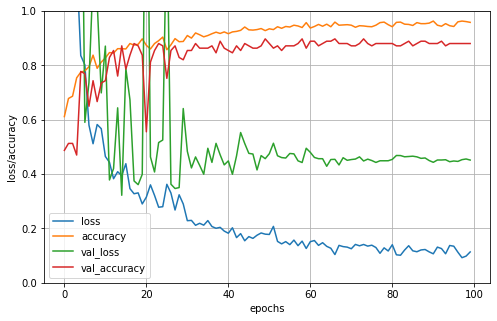

In [ ]:
# visualizing the loss and accuracy
import pandas as pd
import matplotlib.pyplot as plt

pd.DataFrame(history_alex.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

In [ ]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = model_alex.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model_alex.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

4/4 [==============================] - 0s 11ms/step - loss: 0.5736 - accuracy: 0.8571

Test loss / accuracy: 0.5736 / 0.8571
Test ROC AUC: 0.929055963821368


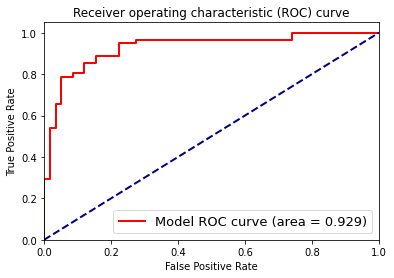

In [ ]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score
import itertools
y_pred_class = model_alex.predict_classes(X_test_scaled) # converting probability predictions into class labels

cm = confusion_matrix(y_test, y_pred_class)
cm

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


array([[54,  4],
       [13, 48]])

### RESNet

In [ ]:
from functools import partial
DefaultConv2D = partial(Conv2D, kernel_size=3, strides=1,
                        padding="SAME", use_bias=False)

class ResidualUnit(tensorflow.keras.layers.Layer):
    def __init__(self, filters, strides=1, activation="relu", **kwargs):
        super().__init__(**kwargs)
        self.activation = tensorflow.keras.activations.get(activation)
        self.main_layers = [
            DefaultConv2D(filters, strides=strides),
            BatchNormalization(),
            self.activation,
            DefaultConv2D(filters),
            BatchNormalization()]
        self.skip_layers = []
        if strides > 1:
            self.skip_layers = [
                DefaultConv2D(filters, kernel_size=1, strides=strides),
                BatchNormalization()]

    def call(self, inputs):
        Z = inputs
        for layer in self.main_layers:
            Z = layer(Z)
        skip_Z = inputs
        for layer in self.skip_layers:
            skip_Z = layer(skip_Z)
        return self.activation(Z + skip_Z)

In [ ]:
tensorflow.keras.backend.clear_session()

model = tensorflow.keras.models.Sequential()
model.add(DefaultConv2D(16, kernel_size=7, strides=2,
                        input_shape=X_train.shape[1:]))
model.add(BatchNormalization())
model.add(tensorflow.keras.layers.Activation("relu"))
model.add(MaxPooling2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [16]*2 + [64] * 2 + [128] * 2:
    strides = 1 if filters == prev_filters else 2
    model.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model.add(GlobalAvgPool2D())
model.add(Flatten())
model.add(Dense(1024,activation='relu'))
model.add(Dropout(0.4)) 
model.add(Dense(512,activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(50, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation="sigmoid"))


batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [ ]:
# train the model
history = model.fit(X_train_scaled, y_train, batch_size = 16, validation_split=0.1, epochs =50)

Epoch 1/50
66/66 [==============================] - 3s 21ms/step - loss: 0.6655 - accuracy: 0.6098 - val_loss: 0.8056 - val_accuracy: 0.5983
Epoch 2/50
66/66 [==============================] - 1s 15ms/step - loss: 0.6021 - accuracy: 0.7513 - val_loss: 2.1245 - val_accuracy: 0.5128
Epoch 3/50
66/66 [==============================] - 1s 15ms/step - loss: 0.5207 - accuracy: 0.7866 - val_loss: 1.0359 - val_accuracy: 0.5214
Epoch 4/50
66/66 [==============================] - 1s 15ms/step - loss: 0.3860 - accuracy: 0.8557 - val_loss: 0.7577 - val_accuracy: 0.7094
Epoch 5/50
66/66 [==============================] - 1s 15ms/step - loss: 0.3737 - accuracy: 0.8398 - val_loss: 0.4117 - val_accuracy: 0.8205
Epoch 6/50
66/66 [==============================] - 1s 15ms/step - loss: 0.3771 - accuracy: 0.8474 - val_loss: 0.3307 - val_accuracy: 0.8376
Epoch 7/50
66/66 [==============================] - 1s 15ms/step - loss: 0.3249 - accuracy: 0.8909 - val_loss: 0.8030 - val_accuracy: 0.7436
Epoch 8/50
66

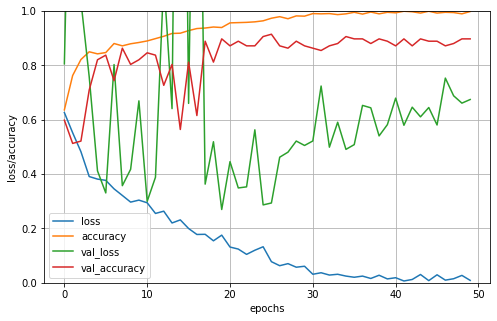

In [ ]:
# visualizing the loss and accuracy
import pandas as pd
import matplotlib.pyplot as plt

pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

### VGG 19 Model

In [ ]:
class VGG19(Sequential):
    def __init__(self, input_shape):
        super().__init__()

        self.add(Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu', input_shape= input_shape))
        self.add(Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Flatten())
        self.add(Dense(4096, activation= 'relu'))
        self.add(Dropout(0.5))
        self.add(Dense(1000, activation= 'relu'))
        self.add(Dropout(0.5))
        self.add(Dense(100, activation= 'relu'))
        self.add(Dropout(0.5))
        self.add(Dense(1, activation='sigmoid'))

        batch_size=16
        s = 30*len(X_train_scaled)//batch_size
        learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

        self.compile(optimizer= Adam(learning_schedule),
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

In [ ]:


model_VGG = VGG19((227, 227, 3))
history_vgg = model_VGG.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.10)



Epoch 1/50
66/66 [==============================] - 12s 137ms/step - loss: 0.7872 - accuracy: 0.4702 - val_loss: 0.6923 - val_accuracy: 0.5214
Epoch 2/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6925 - accuracy: 0.5395 - val_loss: 0.6923 - val_accuracy: 0.5214
Epoch 3/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6940 - accuracy: 0.4984 - val_loss: 0.6922 - val_accuracy: 0.5214
Epoch 4/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6960 - accuracy: 0.4776 - val_loss: 0.6923 - val_accuracy: 0.5214
Epoch 5/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6937 - accuracy: 0.5183 - val_loss: 0.6923 - val_accuracy: 0.5214
Epoch 6/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6943 - accuracy: 0.5182 - val_loss: 0.6922 - val_accuracy: 0.5214
Epoch 7/50
66/66 [==============================] - 7s 103ms/step - loss: 0.6936 - accuracy: 0.4863 - val_loss: 0.6923 - val_accuracy: 0.5214
Epoch

KeyboardInterrupt: ignored

In [ ]:
tensorflow.keras.backend.clear_session()

### GoogleNet

In [ ]:
def inception(x,
              filters_1x1,
              filters_3x3_reduce,
              filters_3x3,
              filters_5x5_reduce,
              filters_5x5,
              filters_pool):
  path1 = layers.Conv2D(filters_1x1, (1, 1), padding='same', activation='relu')(x)

  path2 = layers.Conv2D(filters_3x3_reduce, (1, 1), padding='same', activation='relu')(x)
  path2 = layers.Conv2D(filters_3x3, (1, 1), padding='same', activation='relu')(path2)

  path3 = layers.Conv2D(filters_5x5_reduce, (1, 1), padding='same', activation='relu')(x)
  path3 = layers.Conv2D(filters_5x5, (1, 1), padding='same', activation='relu')(path3)

  path4 = layers.MaxPool2D((3, 3), strides=(1, 1), padding='same')(x)
  path4 = layers.Conv2D(filters_pool, (1, 1), padding='same', activation='relu')(path4)

  return tf.concat([path1, path2, path3, path4], axis=3)


inp = layers.Input(shape=(227, 227, 3))
input_tensor = layers.experimental.preprocessing.Resizing(224, 224, interpolation="bilinear", input_shape=X_train_scaled.shape[1:])(inp)

x = layers.Conv2D(64, 7, strides=2, padding='same', activation='relu')(input_tensor)
x = layers.MaxPooling2D(3, strides=2)(x)

x = layers.Conv2D(64, 1, strides=1, padding='same', activation='relu')(x)
x = layers.Conv2D(192, 3, strides=1, padding='same', activation='relu')(x)

x = layers.MaxPooling2D(3, strides=2)(x)

x = inception(x,
              filters_1x1=64,
              filters_3x3_reduce=96,
              filters_3x3=128,
              filters_5x5_reduce=16,
              filters_5x5=32,
              filters_pool=32)

x = inception(x,
              filters_1x1=128,
              filters_3x3_reduce=128,
              filters_3x3=192,
              filters_5x5_reduce=32,
              filters_5x5=96,
              filters_pool=64)

x = layers.MaxPooling2D(3, strides=2)(x)

x = inception(x,
              filters_1x1=192,
              filters_3x3_reduce=96,
              filters_3x3=208,
              filters_5x5_reduce=16,
              filters_5x5=48,
              filters_pool=64)

aux1 = layers.AveragePooling2D((5, 5), strides=3)(x)
aux1 = layers.Conv2D(128, 1, padding='same', activation='relu')(aux1)
aux1 = layers.Flatten()(aux1)
aux1 = layers.Dense(1024, activation='relu')(aux1)
aux1 = layers.Dropout(0.7)(aux1)
aux1 = layers.Dense(1, activation='sigmoid')(aux1)

x = inception(x,
              filters_1x1=160,
              filters_3x3_reduce=112,
              filters_3x3=224,
              filters_5x5_reduce=24,
              filters_5x5=64,
              filters_pool=64)

x = inception(x,
              filters_1x1=128,
              filters_3x3_reduce=128,
              filters_3x3=256,
              filters_5x5_reduce=24,
              filters_5x5=64,
              filters_pool=64)

x = inception(x,
              filters_1x1=112,
              filters_3x3_reduce=144,
              filters_3x3=288,
              filters_5x5_reduce=32,
              filters_5x5=64,
              filters_pool=64)

aux2 = layers.AveragePooling2D((5, 5), strides=3)(x)
aux2 = layers.Conv2D(128, 1, padding='same', activation='relu')(aux2)
aux2 = layers.Flatten()(aux2)
aux2 = layers.Dense(1024, activation='relu')(aux2)
aux2 = layers.Dropout(0.7)(aux2)
aux2 = layers.Dense(1, activation='sigmoid')(aux2)

x = inception(x,
              filters_1x1=256,
              filters_3x3_reduce=160,
              filters_3x3=320,
              filters_5x5_reduce=32,
              filters_5x5=128,
              filters_pool=128)

x = layers.MaxPooling2D(3, strides=2)(x)

x = inception(x,
              filters_1x1=256,
              filters_3x3_reduce=160,
              filters_3x3=320,
              filters_5x5_reduce=32,
              filters_5x5=128,
              filters_pool=128)

x = inception(x,
              filters_1x1=384,
              filters_3x3_reduce=192,
              filters_3x3=384,
              filters_5x5_reduce=48,
              filters_5x5=128,
              filters_pool=128)

x = layers.GlobalAveragePooling2D()(x)

x = layers.Dropout(0.4)(x)
out = layers.Dense(1, activation='sigmoid')(x)



In [ ]:
model = Model(inputs = inp, outputs = [out, aux1, aux2])

In [ ]:
model.compile(optimizer='adam', loss=[losses.binary_crossentropy, losses.binary_crossentropy, losses.binary_crossentropy], loss_weights=[1, 0.3, 0.3], metrics=['accuracy'])

In [ ]:
history_google = model.fit(X_train_scaled, [labels, labels, labels], validation_split=0.1, batch_size=16, epochs=40)

Epoch 1/40
57/57 [==============================] - 8s 67ms/step - loss: 1.1053 - dense_12_loss: 0.6940 - dense_9_loss: 0.6816 - dense_11_loss: 0.6896 - dense_12_accuracy: 0.5026 - dense_9_accuracy: 0.5217 - dense_11_accuracy: 0.4991 - val_loss: 0.9884 - val_dense_12_loss: 0.6784 - val_dense_9_loss: 0.5095 - val_dense_11_loss: 0.5236 - val_dense_12_accuracy: 0.7624 - val_dense_9_accuracy: 0.7723 - val_dense_11_accuracy: 0.7129
Epoch 2/40
57/57 [==============================] - 2s 43ms/step - loss: 0.9602 - dense_12_loss: 0.6178 - dense_9_loss: 0.5600 - dense_11_loss: 0.5815 - dense_12_accuracy: 0.6695 - dense_9_accuracy: 0.7188 - dense_11_accuracy: 0.7169 - val_loss: 1.1901 - val_dense_12_loss: 0.7495 - val_dense_9_loss: 0.7390 - val_dense_11_loss: 0.7296 - val_dense_12_accuracy: 0.4851 - val_dense_9_accuracy: 0.5248 - val_dense_11_accuracy: 0.4653
Epoch 3/40
57/57 [==============================] - 2s 42ms/step - loss: 1.0458 - dense_12_loss: 0.6645 - dense_9_loss: 0.6155 - dense_11_

### Transfer Learning

Pretrained InceptionV3 in ImageNet data

In [ ]:
tensorflow.keras.backend.clear_session()
import keras
model = keras.applications.InceptionV3(weights = 'imagenet',include_top= False, input_shape=(299, 299, 3))
base_input = model.input
x = model.output
x = GlobalAvgPool2D()(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.4)(x)
final_outputs = Dense(1, activation='sigmoid')(x)
new_model = keras.Model(inputs = base_input, outputs = final_outputs)
new_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 149, 149, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 149, 149, 32) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
# first we freeze all the convulational InceptionV3 layers
for layer in model.layers:
  layer.trainable = False

##### Making the top two convolution layers trainable

In [ ]:
model.get_layer('conv2d_93').trainable= True
model.get_layer('conv2d_85').trainable=True

In [ ]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [ ]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =15, validation_split=0.15)

Epoch 1/15
59/59 [==============================] - 8s 60ms/step - loss: 0.7858 - accuracy: 0.8878 - val_loss: 0.3827 - val_accuracy: 0.9042
Epoch 2/15
59/59 [==============================] - 2s 39ms/step - loss: 0.0920 - accuracy: 0.9643 - val_loss: 0.2683 - val_accuracy: 0.9461
Epoch 3/15
59/59 [==============================] - 2s 38ms/step - loss: 0.0310 - accuracy: 0.9900 - val_loss: 0.1675 - val_accuracy: 0.9461
Epoch 4/15
59/59 [==============================] - 2s 38ms/step - loss: 0.0187 - accuracy: 0.9955 - val_loss: 0.1871 - val_accuracy: 0.9521
Epoch 5/15
59/59 [==============================] - 2s 38ms/step - loss: 0.0047 - accuracy: 0.9992 - val_loss: 0.1978 - val_accuracy: 0.9581
Epoch 6/15
59/59 [==============================] - 2s 39ms/step - loss: 0.0034 - accuracy: 1.0000 - val_loss: 0.2016 - val_accuracy: 0.9641
Epoch 7/15
59/59 [==============================] - 2s 38ms/step - loss: 0.0023 - accuracy: 1.0000 - val_loss: 0.2314 - val_accuracy: 0.9641
Epoch 8/15
59

In [ ]:
new_model.save("MicrostructureClassify.h5")

Let's train the a few top layers

In [ ]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 1s 45ms/step - loss: 0.1906 - accuracy: 0.9716

Test loss / accuracy: 0.1906 / 0.9716
Test ROC AUC: 0.9903038138332256


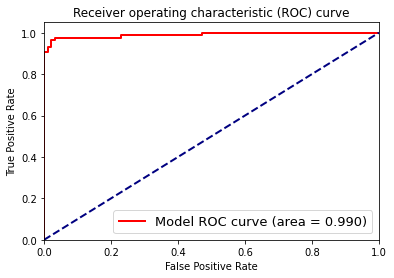

In [ ]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score
import itertools
#y_pred_class = new_model.predict_classes(X_test_scaled) # converting probability predictions into class labels
y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
print('Precision', precision_score(y_pred_class, y_test))
print('Recall', recall_score(y_pred_class, y_test))

Precision 0.9764705882352941
Recall 0.9651162790697675


Confusion matrix, without normalization
[[88  3]
 [ 2 83]]


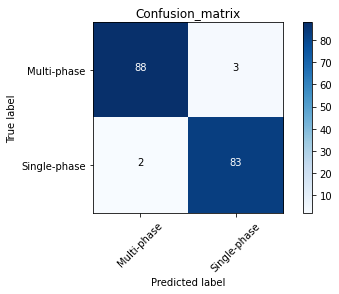

In [ ]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
cm_plot_labels = ['Multi-phase', 'Single-phase'] 

plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0, flags=flags)


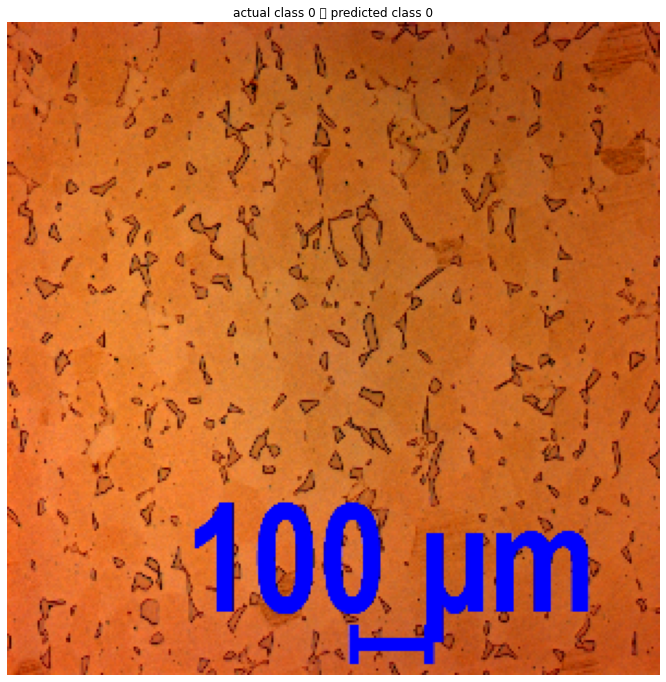

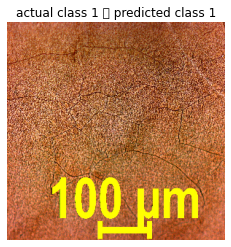

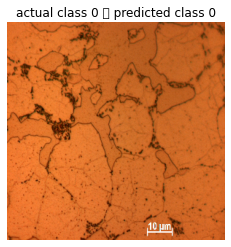

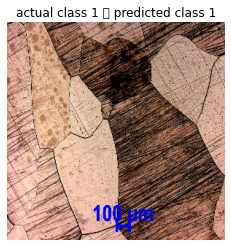

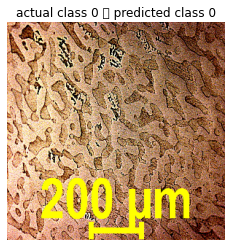

...

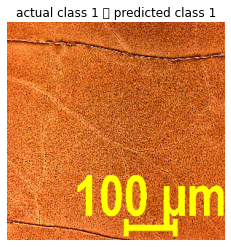

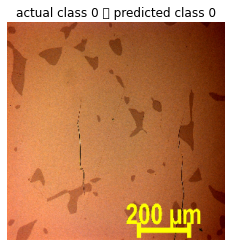

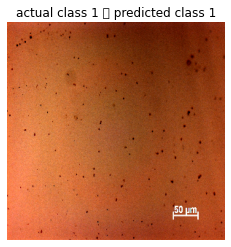

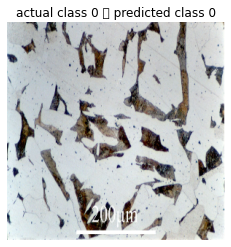

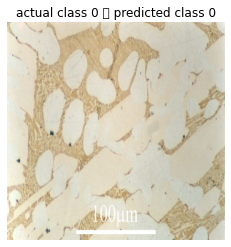

In [ ]:
plt.figure(figsize=(12,12))
index=0
for img in X_test:
    plt.imshow(img)
    plt.title("actual class {} \t predicted class {}".format(y_test[index], y_pred_class[index]))
    index +=1
    plt.axis("off")
    plt.show()

### Try Pretrained VGG16

In [ ]:
from keras.applications.vgg16 import VGG16
model = VGG16(include_top = False, input_shape=(299, 299, 3))
# adding custom dense layers
flat1 = Flatten()(model.layers[-1].output)
dense1 = Dense(1024, activation='relu')(flat1)
drop = Dropout(0.4)(dense1)
final_output = Dense(1, activation='sigmoid')(drop)

new_model = Model(inputs = model.inputs, outputs = final_output)

#new_model.summary()

In [ ]:
for layer in model.layers:
  layer.trainable = False

In [ ]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])


In [ ]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =10, validation_split=0.15)

Epoch 1/10
59/59 [==============================] - 6s 84ms/step - loss: 2.8744 - accuracy: 0.7664 - val_loss: 0.4280 - val_accuracy: 0.9222
Epoch 2/10
59/59 [==============================] - 5s 78ms/step - loss: 0.5960 - accuracy: 0.9200 - val_loss: 0.2934 - val_accuracy: 0.9521
Epoch 3/10
59/59 [==============================] - 5s 78ms/step - loss: 0.2924 - accuracy: 0.9477 - val_loss: 0.1712 - val_accuracy: 0.9581
Epoch 4/10
59/59 [==============================] - 5s 78ms/step - loss: 0.1199 - accuracy: 0.9645 - val_loss: 0.1246 - val_accuracy: 0.9581
Epoch 5/10
59/59 [==============================] - 5s 78ms/step - loss: 0.0900 - accuracy: 0.9706 - val_loss: 0.1788 - val_accuracy: 0.9521
Epoch 6/10
59/59 [==============================] - 5s 78ms/step - loss: 0.0583 - accuracy: 0.9733 - val_loss: 0.1504 - val_accuracy: 0.9581
Epoch 7/10
59/59 [==============================] - 5s 78ms/step - loss: 0.0567 - accuracy: 0.9755 - val_loss: 0.1487 - val_accuracy: 0.9581
Epoch 8/10
59

Let's train last convolution layer

In [ ]:
model.get_layer('block5_conv1').trainable= True
model.get_layer('block5_conv2').trainable=True
model.get_layer('block5_conv3').trainable=True

In [ ]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [ ]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =30, validation_split=0.15, callbacks = [tensorflow.keras.callbacks.EarlyStopping(patience=10)])

Epoch 1/30
59/59 [==============================] - 6s 93ms/step - loss: 0.5446 - accuracy: 0.8416 - val_loss: 0.3633 - val_accuracy: 0.8802
Epoch 2/30
59/59 [==============================] - 5s 87ms/step - loss: 0.2293 - accuracy: 0.9200 - val_loss: 0.7181 - val_accuracy: 0.9281
Epoch 3/30
59/59 [==============================] - 5s 87ms/step - loss: 0.3145 - accuracy: 0.8845 - val_loss: 0.2570 - val_accuracy: 0.9042
Epoch 4/30
59/59 [==============================] - 5s 87ms/step - loss: 0.3508 - accuracy: 0.9020 - val_loss: 0.3529 - val_accuracy: 0.9222
Epoch 5/30
59/59 [==============================] - 5s 87ms/step - loss: 0.2482 - accuracy: 0.9133 - val_loss: 0.2725 - val_accuracy: 0.9281
Epoch 6/30
59/59 [==============================] - 5s 87ms/step - loss: 0.1749 - accuracy: 0.9274 - val_loss: 0.3185 - val_accuracy: 0.9341
Epoch 7/30
59/59 [==============================] - 5s 87ms/step - loss: 0.1114 - accuracy: 0.9498 - val_loss: 0.3784 - val_accuracy: 0.9521
Epoch 8/30
59

In [ ]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 1s 104ms/step - loss: 0.6034 - accuracy: 0.9318

Test loss / accuracy: 0.6034 / 0.9318
Test ROC AUC: 0.9711053652230124


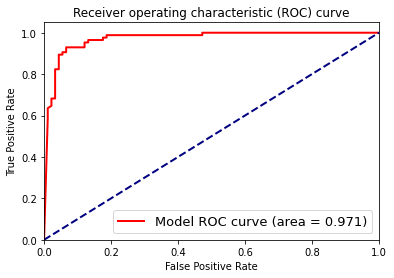

In [ ]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

Confusion matrix, without normalization
[[85  6]
 [ 6 79]]
Precision_score: 0.9294117647058824
Recall_score: 0.9294117647058824


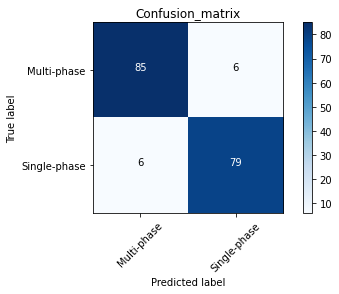

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score
import itertools
#y_pred_class = new_model.predict_classes(X_test_scaled) # converting probability predictions into class labels
y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)

plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')
print('Precision_score:',precision_score(y_test, y_pred_class))
print('Recall_score:',recall_score(y_test, y_pred_class))